<a href="https://colab.research.google.com/github/MaDufie/ml_journey/blob/feature%2Fprediction-jan-2024/2401_training_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#connect to google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !pip install catboost
# !pip install lightgbm

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas.plotting import scatter_matrix
from sklearn.feature_selection import mutual_info_classif
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold, StratifiedKFold, cross_val_score,cross_validate
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from xgboost import XGBClassifier
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier
from sklearn.ensemble import HistGradientBoostingClassifier

In [ ]:
# df = pd.read_csv('/content/drive/MyDrive/My ML Journey/flight_arrival_delay_prediction/data/may_2024_data/merged_df_10 .csv')
df = pd.read_csv('./merged_df_10 .csv')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55114 entries, 0 to 55113
Data columns (total 83 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   YEAR                           55114 non-null  int64  
 1   QUARTER                        55114 non-null  int64  
 2   MONTH                          55114 non-null  int64  
 3   DAY_OF_MONTH                   55114 non-null  int64  
 4   DAY_OF_WEEK                    55114 non-null  int64  
 5   MKT_UNIQUE_CARRIER             55114 non-null  object 
 6   MKT_CARRIER_FL_NUM             55114 non-null  int64  
 7   OP_UNIQUE_CARRIER              55114 non-null  object 
 8   ORIGIN_AIRPORT_ID              55114 non-null  int64  
 9   ORIGIN                         55114 non-null  object 
 10  ORIGIN_CITY_NAME               55114 non-null  object 
 11  ORIGIN_STATE_ABR               55114 non-null  object 
 12  DEST_AIRPORT_ID                55114 non-null 

In [ ]:
df.columns

Index(['YEAR', 'QUARTER', 'MONTH', 'DAY_OF_MONTH', 'DAY_OF_WEEK',
       'MKT_UNIQUE_CARRIER', 'MKT_CARRIER_FL_NUM', 'OP_UNIQUE_CARRIER',
       'ORIGIN_AIRPORT_ID', 'ORIGIN', 'ORIGIN_CITY_NAME', 'ORIGIN_STATE_ABR',
       'DEST_AIRPORT_ID', 'DEST', 'DEST_CITY_NAME', 'DEST_STATE_ABR',
       'CRS_DEP_TIME', 'DEP_TIME', 'DEP_DELAY', 'DEP_DELAY_NEW', 'TAXI_OUT',
       'TAXI_IN', 'CRS_ARR_TIME', 'ARR_TIME', 'ARR_DELAY', 'ARR_DELAY_NEW',
       'CRS_ELAPSED_TIME', 'ACTUAL_ELAPSED_TIME', 'AIR_TIME', 'DISTANCE',
       'CARRIER_DELAY', 'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY',
       'LATE_AIRCRAFT_DELAY', 'CRS_DEP_TIME_OF_DAY', 'CRS_ARR_TIME_OF_DAY',
       'ARR_DELAY_CLASS', 'CARRIER_NUM', 'In-Degree Centrality_ORIGIN',
       'Out-Degree Centrality_ORIGIN', 'Betweenness Centrality_ORIGIN',
       'Closeness Centrality_ORIGIN', 'In-Degree Centrality_DEST',
       'Out-Degree Centrality_DEST', 'Betweenness Centrality_DEST',
       'Closeness Centrality_DEST', 'weather_code_ORIGIN',
 

# Data Preprocessing

In [ ]:
data = df[['DAY_OF_MONTH', 'DAY_OF_WEEK', 'MKT_UNIQUE_CARRIER', 'MKT_CARRIER_FL_NUM', 'ORIGIN', 'DEST', 'CRS_DEP_TIME', 'CRS_ARR_TIME', 'CRS_ELAPSED_TIME', 'ARR_DELAY_CLASS', 'Out-Degree Centrality_ORIGIN',
       'In-Degree Centrality_DEST',  'temperature_2m_ORIGIN', 'relative_humidity_2m_ORIGIN', 'surface_pressure_ORIGIN', 'precipitation_ORIGIN', 'snowfall_ORIGIN', 'cloudcover_low_ORIGIN', 'cloud_cover_mid_ORIGIN',
       'cloud_cover_high_ORIGIN', 'wind_speed_100m_ORIGIN', 'wind_direction_100m_ORIGIN', 'weather_code_DEST', 'temperature_2m_DEST', 'relative_humidity_2m_DEST', 'surface_pressure_DEST', 'precipitation_DEST',
       'snowfall_DEST', 'cloudcover_low_DEST', 'cloud_cover_mid_DEST', 'cloud_cover_high_DEST', 'wind_speed_100m_DEST', 'wind_direction_10m_DEST']]

In [ ]:
data.columns = data.columns.str.replace(' ', '_')

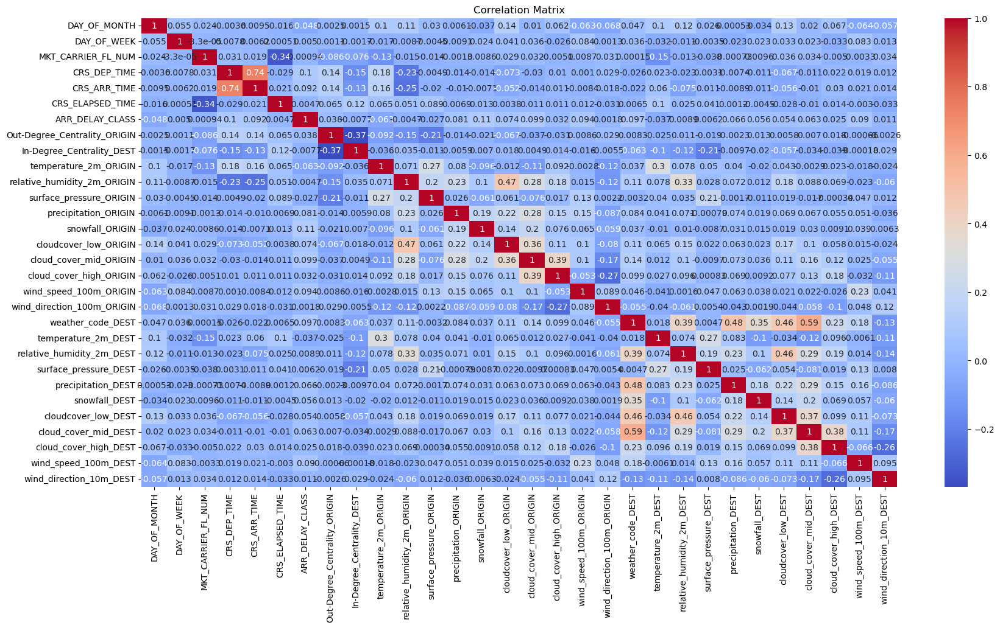

CPU times: total: 1.84 s
Wall time: 2.18 s


In [ ]:
%%time
plt.figure(figsize=(20,10))
numerical_df = data.select_dtypes(include=['number'])
correlation_matrix = numerical_df.corr()
# print(correlation_matrix)
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

In [ ]:
%%time
sns.pairplot(data)

CPU times: total: 1min 53s
Wall time: 2min 4s


## Encoding Categorical Data

In [ ]:
%%time
# Applying One-Hot Encoding to the "MKT_UNIQUE_CARRIER" column
data = pd.get_dummies(data, columns=['MKT_UNIQUE_CARRIER'], prefix='MKT_UNIQUE_CARRIER')
for col in data.columns:
    if col.startswith('MKT_UNIQUE_CARRIER_'):
        data[col] = data[col].astype(int)
data.head()

CPU times: total: 31.2 ms
Wall time: 45.3 ms


,DAY_OF_MONTH,DAY_OF_WEEK,MKT_CARRIER_FL_NUM,ORIGIN,DEST,CRS_DEP_TIME,CRS_ARR_TIME,CRS_ELAPSED_TIME,ARR_DELAY_CLASS,Out-Degree_Centrality_ORIGIN,...,MKT_UNIQUE_CARRIER_AA,MKT_UNIQUE_CARRIER_AS,MKT_UNIQUE_CARRIER_B6,MKT_UNIQUE_CARRIER_DL,MKT_UNIQUE_CARRIER_F9,MKT_UNIQUE_CARRIER_G4,MKT_UNIQUE_CARRIER_HA,MKT_UNIQUE_CARRIER_NK,MKT_UNIQUE_CARRIER_UA,MKT_UNIQUE_CARRIER_WN
0,3,3,1861,ATL,SJU,1135,1401,206.0,0,0.420000,...,0,0,0,1,0,0,0,0,0,0
1,24,3,1575,CLT,BWI,380,465,85.0,0,0.377143,...,0,0,0,0,0,0,0,0,0,1
2,16,2,1584,SAT,HOU,1055,1120,65.0,0,0.097143,...,0,0,0,0,0,0,0,0,0,1
3,27,6,4182,PHX,IAH,600,815,155.0,0,0.300000,...,0,0,0,0,1,0,0,0,0,0
4,8,1,276,SFO,JFK,1353,430,337.0,0,0.214286,...,1,0,0,0,0,0,0,0,0,0


In [ ]:
%%time
# Applying One-Hot Encoding to the "MKT_CARRIER_FL_NUM" column
data = pd.get_dummies(data, columns=['MKT_CARRIER_FL_NUM'], prefix='MKT_CARRIER_FL_NUM')
for col in data.columns:
    if col.startswith('MKT_CARRIER_FL_NUM_'):
        data[col] = data[col].astype(int)
data.head()

CPU times: total: 2.31 s
Wall time: 4.25 s


,DAY_OF_MONTH,DAY_OF_WEEK,ORIGIN,DEST,CRS_DEP_TIME,CRS_ARR_TIME,CRS_ELAPSED_TIME,ARR_DELAY_CLASS,Out-Degree_Centrality_ORIGIN,In-Degree_Centrality_DEST,...,MKT_CARRIER_FL_NUM_6452,MKT_CARRIER_FL_NUM_6455,MKT_CARRIER_FL_NUM_8770,MKT_CARRIER_FL_NUM_8800,MKT_CARRIER_FL_NUM_8803,MKT_CARRIER_FL_NUM_8811,MKT_CARRIER_FL_NUM_9681,MKT_CARRIER_FL_NUM_9682,MKT_CARRIER_FL_NUM_9683,MKT_CARRIER_FL_NUM_9685
0,3,3,ATL,SJU,1135,1401,206.0,0,0.420000,0.082857,...,0,0,0,0,0,0,0,0,0,0
1,24,3,CLT,BWI,380,465,85.0,0,0.377143,0.182857,...,0,0,0,0,0,0,0,0,0,0
2,16,2,SAT,HOU,1055,1120,65.0,0,0.097143,0.191429,...,0,0,0,0,0,0,0,0,0,0
3,27,6,PHX,IAH,600,815,155.0,0,0.300000,0.305714,...,0,0,0,0,0,0,0,0,0,0
4,8,1,SFO,JFK,1353,430,337.0,0,0.214286,0.185714,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
%%time
# Applying One-Hot Encoding to the "ORIGIN" column
data = pd.get_dummies(data, columns=['ORIGIN'], prefix='ORIGIN')
for col in data.columns:
    if col.startswith('ORIGIN_'):
        data[col] = data[col].astype(int)
data.head()

CPU times: total: 3.05 s
Wall time: 4.76 s


,DAY_OF_MONTH,DAY_OF_WEEK,DEST,CRS_DEP_TIME,CRS_ARR_TIME,CRS_ELAPSED_TIME,ARR_DELAY_CLASS,Out-Degree_Centrality_ORIGIN,In-Degree_Centrality_DEST,temperature_2m_ORIGIN,...,ORIGIN_VCT,ORIGIN_VEL,ORIGIN_VLD,ORIGIN_VPS,ORIGIN_WRG,ORIGIN_XNA,ORIGIN_XWA,ORIGIN_YAK,ORIGIN_YKM,ORIGIN_YUM
0,3,3,SJU,1135,1401,206.0,0,0.420000,0.082857,6.3,...,0,0,0,0,0,0,0,0,0,0
1,24,3,BWI,380,465,85.0,0,0.377143,0.182857,8.6,...,0,0,0,0,0,0,0,0,0,0
2,16,2,HOU,1055,1120,65.0,0,0.097143,0.191429,1.9,...,0,0,0,0,0,0,0,0,0,0
3,27,6,IAH,600,815,155.0,0,0.300000,0.305714,12.3,...,0,0,0,0,0,0,0,0,0,0
4,8,1,JFK,1353,430,337.0,0,0.214286,0.185714,10.2,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
%%time
# Applying One-Hot Encoding to the "DEST" column
data = pd.get_dummies(data, columns=['DEST'], prefix='DEST')
for col in data.columns:
    if col.startswith('DEST_'):
        data[col] = data[col].astype(int)
data.head()

CPU times: total: 1.44 s
Wall time: 3.68 s


,DAY_OF_MONTH,DAY_OF_WEEK,CRS_DEP_TIME,CRS_ARR_TIME,CRS_ELAPSED_TIME,ARR_DELAY_CLASS,Out-Degree_Centrality_ORIGIN,In-Degree_Centrality_DEST,temperature_2m_ORIGIN,relative_humidity_2m_ORIGIN,...,DEST_VCT,DEST_VEL,DEST_VLD,DEST_VPS,DEST_WRG,DEST_XNA,DEST_XWA,DEST_YAK,DEST_YKM,DEST_YUM
0,3,3,1135,1401,206.0,0,0.420000,0.082857,6.3,60,...,0,0,0,0,0,0,0,0,0,0
1,24,3,380,465,85.0,0,0.377143,0.182857,8.6,99,...,0,0,0,0,0,0,0,0,0,0
2,16,2,1055,1120,65.0,0,0.097143,0.191429,1.9,21,...,0,0,0,0,0,0,0,0,0,0
3,27,6,600,815,155.0,0,0.300000,0.305714,12.3,60,...,0,0,0,0,0,0,0,0,0,0
4,8,1,1353,430,337.0,0,0.214286,0.185714,10.2,90,...,0,0,0,0,0,0,0,0,0,0


## Features (X) and Target (y) variable

In [ ]:
%%time
X = data.drop(columns=['ARR_DELAY_CLASS'])
y = data['ARR_DELAY_CLASS']

CPU times: total: 391 ms
Wall time: 1.43 s


## Feature Importance using Information Gain

In [ ]:
%%time
# Calculating the Information Gain for each feature
information_gain = mutual_info_classif(X, y, discrete_features='auto')

# Creating a DataFrame to view the results
info_gain_df = pd.DataFrame({'Feature': X.columns, 'Information Gain': information_gain})

# Sorting the features by Information Gain
info_gain_df = info_gain_df.sort_values(by='Information Gain', ascending=False)

CPU times: total: 22min 7s
Wall time: 36min 51s


In [ ]:
info_gain_df.head(30)

,Feature,Information Gain
0,DAY_OF_MONTH,0.029975
9,surface_pressure_ORIGIN,0.011063
7,temperature_2m_ORIGIN,0.009945
10,precipitation_ORIGIN,0.008996
15,wind_speed_100m_ORIGIN,0.008343
20,surface_pressure_DEST,0.008157
11,snowfall_ORIGIN,0.008082
2,CRS_DEP_TIME,0.007062
5230,MKT_CARRIER_FL_NUM_5301,0.006846
3999,MKT_CARRIER_FL_NUM_3993,0.006794


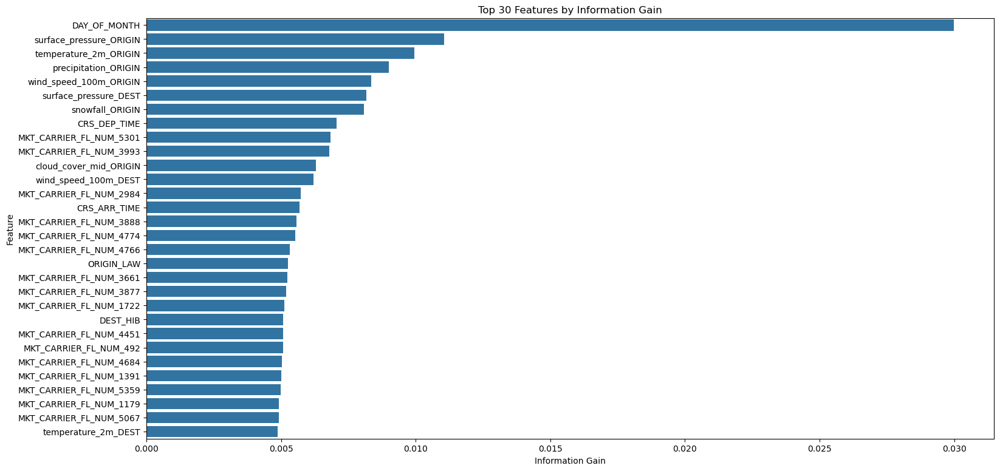

In [ ]:
# plot the top 20 results for information gain
top_30_info_gain = info_gain_df.head(30)

plt.figure(figsize=(18, 9))
sns.barplot(x='Information Gain', y='Feature', data=top_30_info_gain)
plt.title('Top 30 Features by Information Gain')
plt.xlabel('Information Gain')
plt.ylabel('Feature')
plt.show()

## Feature Scaling

In [ ]:
%%time
scaler = StandardScaler().set_output(transform="pandas")
scaled_X = scaler.fit_transform(X)

CPU times: total: 7.39 s
Wall time: 8.07 s


# StratifiedKFold Cross Validation

In [ ]:
# Initializing StratifiedKFold with 5 splits
stratified_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

## Evaluation Method

In [ ]:
def evaluate_model_cv(model, x, y, kf):
    # Define scoring metrics
    scoring = {
        'accuracy': 'accuracy',
        'precision': 'precision',
        'recall': 'recall',
        'f1': 'f1',
        'roc_auc': 'roc_auc'
    }

    # Perform cross-validation
    cv_results = cross_validate(model, x, y, cv=kf, scoring=scoring)

    # Extract the metrics
    accuracy = cv_results['test_accuracy']
    precision = cv_results['test_precision']
    recall = cv_results['test_recall']
    f1 = cv_results['test_f1']
    roc_auc = cv_results['test_roc_auc']

    # Create a DataFrame to hold the results
    metrics_df = pd.DataFrame({
        'Fold': np.arange(1, kf.get_n_splits(x) + 1),
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1-Score': f1,
        'AUC-ROC': roc_auc
    })

    # Plot the results
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=metrics_df, x='Fold', y='Accuracy', marker='o', label='Accuracy')
    sns.lineplot(data=metrics_df, x='Fold', y='Precision', marker='o', label='Precision')
    sns.lineplot(data=metrics_df, x='Fold', y='Recall', marker='o', label='Recall')
    sns.lineplot(data=metrics_df, x='Fold', y='F1-Score', marker='o', label='F1-Score')
    sns.lineplot(data=metrics_df, x='Fold', y='AUC-ROC', marker='o', label='AUC-ROC')

    plt.title(f'{model.__class__.__name__} Model Performance Across Folds')
    plt.xlabel('Fold')
    plt.ylabel('Score')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Print the mean scores
    print(f'Mean Accuracy: {accuracy.mean()}')
    print(f'Mean Precision: {precision.mean()}')
    print(f'Mean Recall: {recall.mean()}')
    print(f'Mean F1-Score: {f1.mean()}')
    print(f'Mean AUC-ROC: {roc_auc.mean()}')

# Model Training

## Decision Tree Classifier

In [ ]:
%%time
dt_model = DecisionTreeClassifier(random_state=42)

CPU times: total: 0 ns
Wall time: 1.03 ms


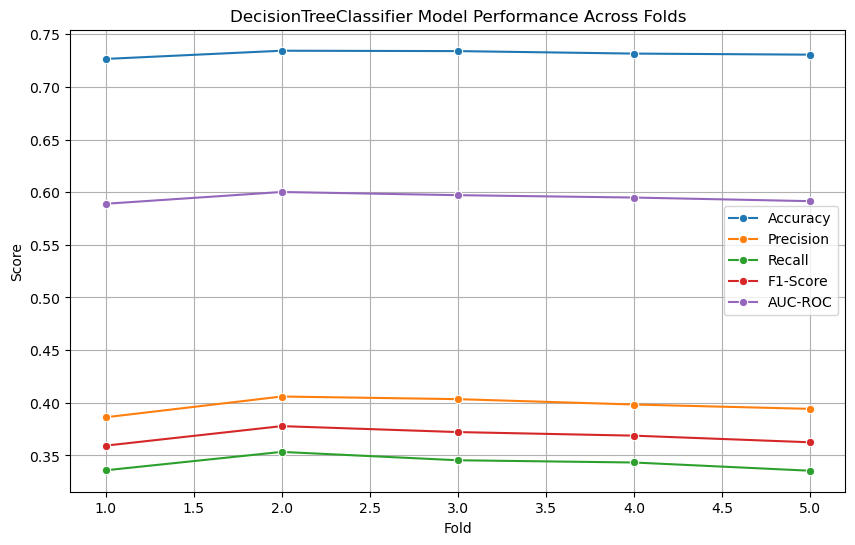

Mean Accuracy: 0.7314475302485673
Mean Precision: 0.39762350907482535
Mean Recall: 0.342659517822527
Mean F1-Score: 0.3680940223691818
Mean AUC-ROC: 0.594554092968905
CPU times: total: 2min 18s
Wall time: 2min 28s


In [ ]:
%%time
evaluate_model_cv(dt_model, scaled_X, y, stratified_kf)

## Logistic Regression

In [ ]:
%%time
lr_model = LogisticRegression(max_iter=1000)

CPU times: total: 0 ns
Wall time: 2.01 ms


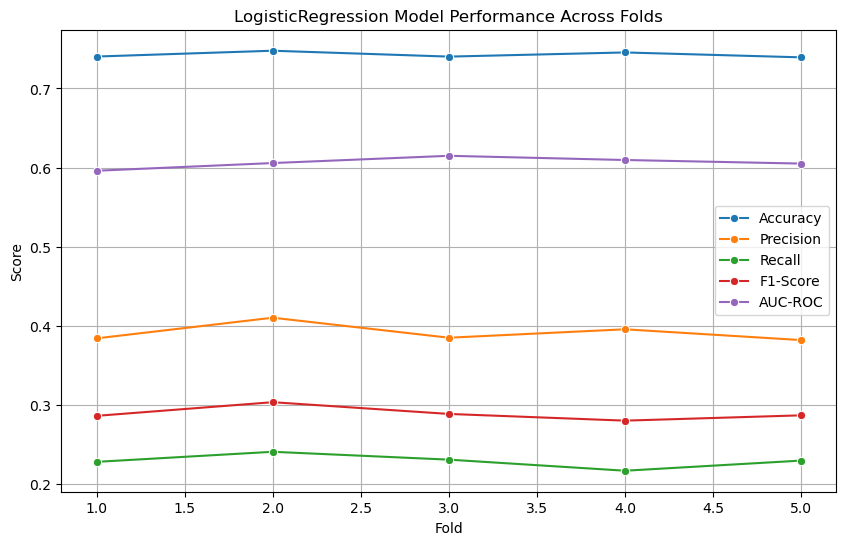

Mean Accuracy: 0.7426424628413828
Mean Precision: 0.39143849025015587
Mean Recall: 0.2293150298163269
Mean F1-Score: 0.28912930053239794
Mean AUC-ROC: 0.6062774998680875
CPU times: total: 2min 18s
Wall time: 2min 16s


In [ ]:
%%time
evaluate_model_cv(lr_model, scaled_X, y, stratified_kf)

## Random Forest Classifier

In [ ]:
%%time
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

CPU times: total: 0 ns
Wall time: 67.5 ms


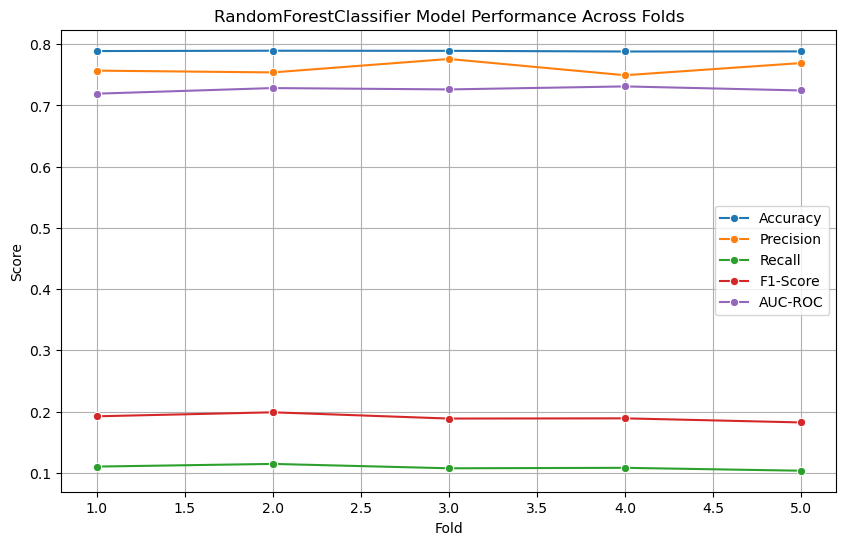

Mean Accuracy: 0.788728807796397
Mean Precision: 0.7610322871251407
Mean Recall: 0.1086559566647907
Mean F1-Score: 0.19012443581372165
Mean AUC-ROC: 0.7258296270924364
CPU times: total: 9min 27s
Wall time: 9min 49s


In [ ]:
%%time
evaluate_model_cv(rf_model, scaled_X, y, stratified_kf)

## XGBoost Classifier

In [ ]:
%%time
xgb_model = XGBClassifier(eval_metric='logloss', random_state=42)

CPU times: total: 0 ns
Wall time: 153 ms


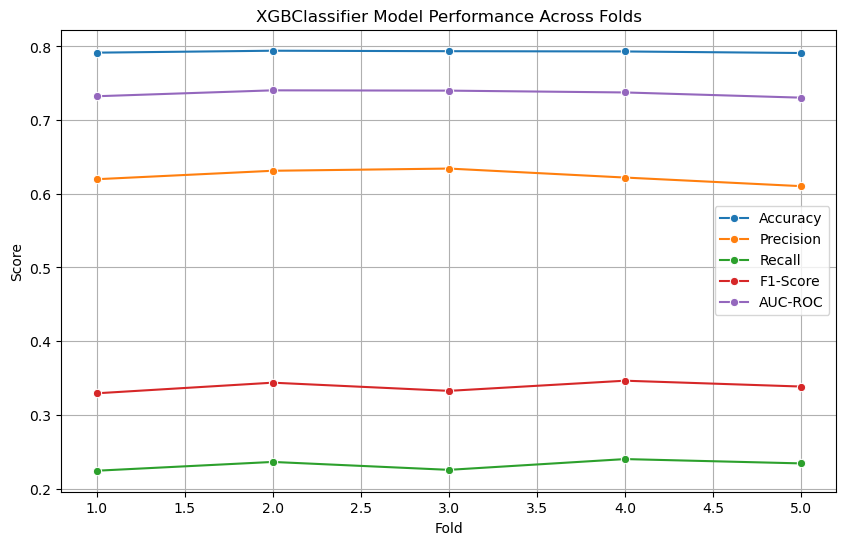

Mean Accuracy: 0.7926842248798898
Mean Precision: 0.6235307190084624
Mean Recall: 0.23193640952177025
Mean F1-Score: 0.3380375194910793
Mean AUC-ROC: 0.7361541551830196
CPU times: total: 21min 35s
Wall time: 3min 33s


In [ ]:
%%time
evaluate_model_cv(xgb_model, scaled_X, y, stratified_kf)

## CatBoost Classifier

In [ ]:
%%time
catboost_model = CatBoostClassifier(iterations=100, verbose=0, random_state=42)

CPU times: total: 0 ns
Wall time: 49.2 ms


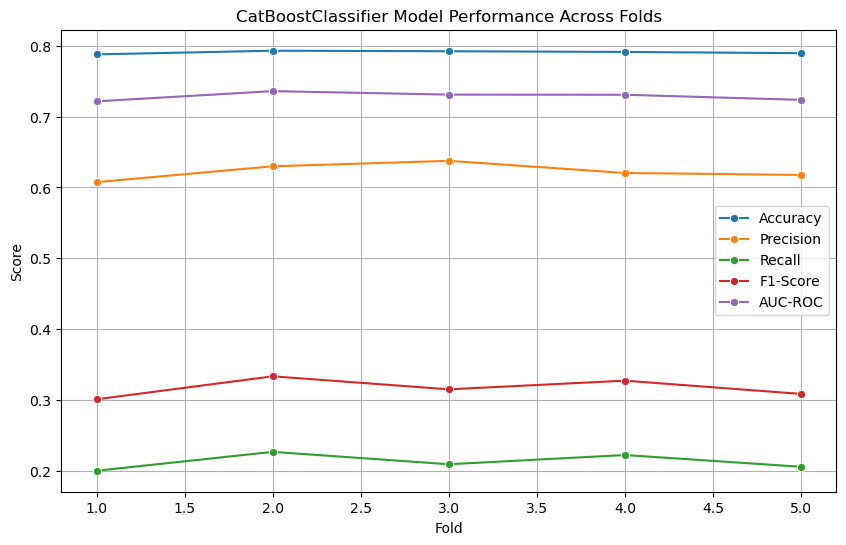

Mean Accuracy: 0.7908516665628769
Mean Precision: 0.6226003772718361
Mean Recall: 0.21262145550163497
Mean F1-Score: 0.3168842847039376
Mean AUC-ROC: 0.7286379863055488
CPU times: total: 2min 5s
Wall time: 50.6 s


In [ ]:
%%time
evaluate_model_cv(catboost_model, scaled_X, y, stratified_kf)

## LightGBM Classifier

In [ ]:
%%time
lgbm_model = LGBMClassifier(random_state=42)

CPU times: total: 0 ns
Wall time: 0 ns


[LightGBM] [Info] Number of positive: 10065, number of negative: 34026
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.041992 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5340
[LightGBM] [Info] Number of data points in the train set: 44091, number of used features: 469
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.228278 -> initscore=-1.218061
[LightGBM] [Info] Start training from score -1.218061
[LightGBM] [Info] Number of positive: 10065, number of negative: 34026
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.040611 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5302
[LightGBM] [Info] Number of data points in the train set: 44091, number of used features: 456
[LightGBM] [Info

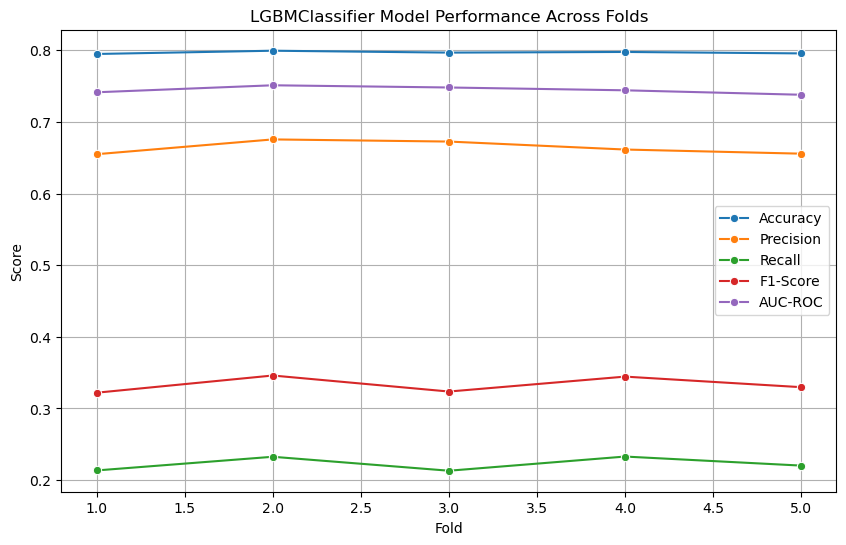

Mean Accuracy: 0.7968029681690448
Mean Precision: 0.6639880973826762
Mean Recall: 0.22239802727778607
Mean F1-Score: 0.33310623550377394
Mean AUC-ROC: 0.7444719141477558
CPU times: total: 2min 32s
Wall time: 2min 20s


In [ ]:
%%time
evaluate_model_cv(lgbm_model, scaled_X, y, stratified_kf)

## Hist Gradient Boosting Classifier

In [ ]:
%%time
hgb_model = HistGradientBoostingClassifier(random_state=42)

CPU times: total: 0 ns
Wall time: 0 ns


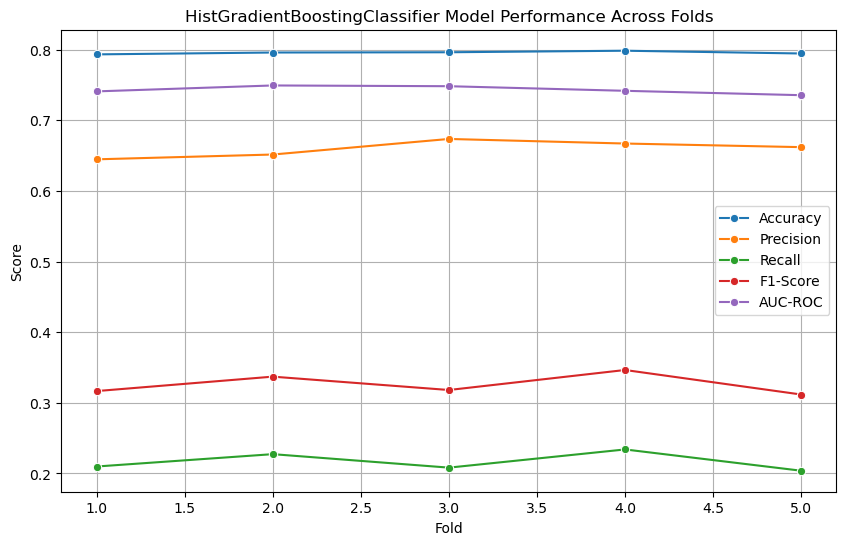

Mean Accuracy: 0.795659883913731
Mean Precision: 0.6597341569765973
Mean Recall: 0.21667456210329378
Mean F1-Score: 0.3260182480800151
Mean AUC-ROC: 0.7430907530103561
CPU times: total: 25min 55s
Wall time: 10min 1s


In [ ]:
%%time
evaluate_model_cv(hgb_model, scaled_X, y, stratified_kf)